## 1. Import Modules

In [0]:
!pip install spacy transformers
!spacy download en_core_web_sm
!pip install torch
!pip install spacy
!pip install nltk
!pip install wordcloud
!pip install tensorflow
!pip install keras.utils

     |████████████████████████████████| 6.2 MB 5.2 MB/s 
     |████████████████████████████████| 3.5 MB 57.6 MB/s 
     |████████████████████████████████| 181 kB 54.2 MB/s 
     |████████████████████████████████| 454 kB 48.9 MB/s 
     |████████████████████████████████| 42 kB 2.4 MB/s 
     |████████████████████████████████| 13.7 MB 10.7 MB/s 
     |████████████████████████████████| 636 kB 29.3 MB/s 
     |████████████████████████████████| 130 kB 50.2 MB/s 
     |████████████████████████████████| 9.9 MB 42.1 MB/s 
     |████████████████████████████████| 58 kB 8.5 MB/s 
     |████████████████████████████████| 895 kB 22.1 MB/s 
     |████████████████████████████████| 701 kB 53.2 MB/s 
     |████████████████████████████████| 6.8 MB 41.4 MB/s 
     |████████████████████████████████| 67 kB 9.6 MB/s 
You should consider upgrading via the '/databricks/python3/bin/python -m pip install --upgrade pip' command.
2022-02-15 18:45:10.318592: W tensorflow/stream_executor/platform/default/dso_loader.

In [0]:
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer
import spacy
from transformers import AutoModel, AutoTokenizer
import torch
from sklearn.metrics.pairwise import cosine_similarity
import ast
from nltk.probability import FreqDist
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from sklearn import preprocessing
import ast
import contractions
import string
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import nltk
nltk.download('wordnet')
nltk.download('averaged_perceptron_tagger')
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('omw-1.4')
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.corpus import wordnet
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import TextVectorization
from tensorflow.keras.layers import Embedding
from tensorflow.keras import layers

## 2. Read Files

In [0]:
reviewsDF = (spark.read
  .option("inferSchema", True)
  .json("/FileStore/tables/Project_Data_Extract/reviews.json"))

reviewsDF.display()

aspect_category,business_id,comp_score,sentiment,stars,text
SERVICE#GENERAL,SfkRN960vVQ74mbowSEuXQ,0.8074,positive,5.0,affordable price fast service friendly dog name rambo place great
FOOD#QUALITY,YZs1gNSh_sN8JmN_nrpxeA,0.8805,positive,5.0,one favorite bbq place town meat side fantastic smell like table locate inside smoker noise level manageable highly recommend
FOOD#QUALITY,gGvNgShksetPoimyKV8I9Q,-0.6486,negative,1.0,rate food walk seat wait minute waitress approach state would back take drink order come back another minute later take drink order wait minute get even drink decide leave bad service I ever even busy
FOOD#QUALITY,ttZRucfe1fcN_DX2ZGZ1Vg,0.9775,positive,3.0,restaurant conveniently locate street fox easy spot grab quick bite show sunday although restaurant italian fairly limited selection pasta service inconsistent despite extremely crowd flag waitress time refill bread monday friday offer wine despite go sunday bartender gracious enough honor special friend order gorgonzola salad chicken take well min deliver table salad average bit overprice may due area bruschetta flavorful calamari well season restaurant good spot partake wine week service leaf little desire however hopefully would well week
SERVICE#GENERAL,R0IJhEI-zSJpYT1YN_orWQ,0.9607,positive,5.0,nail salon amaze nikki thao kathy anna talented really listen customer salon amaze amount color I see area also stay trend fun design love place
FOOD#QUALITY,qDyZQ6mT1JajQ7_Yj7PeLw,0.994,positive,4.0,food star service star I go average star really great spot especially shopping domain want drop nonpeak time since get pretty busy love option sit bar get small party first come first serve goto spot crave japanese beer tap favorite spicy chicken ramen get spiciest level good heat nice veggie umami flavor thin noodle number appetizer well standouts brussel sprout crispy chicken also get great combo add thing like crispy chicken salad ramen order fiance often split food go beer real complaint service leaf something desire well often ask thing twice go hunt waiter ask water napkin etc order drink get wait minute food also friendliest staff experienced though get feel lot time feel slammedoverwhelmed high volume customer still pleasant experience crowd restaurant think unreasonable want friendliermore helpful staff overall food beerhot sake tap make worthwhile go try go happy houroff time
SERVICE#GENERAL,X7ZPCV8jyS5rw_bI0aWNNA,0.9468,positive,5.0,rent local spot large family reunion conveniently locate amaze service friendliest reception meaningful reunion definitely book thank make family feel like royalty
FOOD#QUALITY,3Ck6jp7qFRB4twIOXWA2Pw,-0.4653,negative,2.0,reason give dillards two star instead one quality merchandise customer service get negative last time perfume counter look sample five minute saw sale lady help three people come one couple even interested perfume stand near counter still come way help ready buy holiday gift felt disrespect go another sale lady ask elevator even look register point without word corner store even elevator locate also pretend see show interest jacket department left store without give business many quality store quality merchandise quality service tolerate arrogance disrespect prejudice anyone go shopping positive experience negative one
SERVICE#GENERAL,Y2cj0TQvfSdRU3H55CkEgA,-0.7783,negative,1.0,service awful charge wrong size inform worker told even matter
FOOD#QUALITY,XxixtrEXLI9Rr1Ojaq70Zw,0.8625,positive,5.0,casual atmosphere great view service food delicious drink hit spot


In [0]:
tipsDF = (spark.read
  .option("inferSchema", True)
  .json("/FileStore/tables/Project_Data_Extract/dataset_tips.json"))

tipsDF.display()

business_id,date,text_w/o_stopwords,tips_comp_score
ENwBByjpoa5Gg7tKgxqwLg,2011-07-22T19:07:35.000Z,carne asada chips,0.0
jKO4Og6ucdX2-YCTKQVYjg,2014-09-10T07:33:29.000Z,best happy hour pm pm martinis fridays nothing pink delicious,0.7097
9Bto7mky640ocgezVKSfVg,2013-12-13T23:23:41.000Z,nice people skilled staff clean location think I ever taken time years,0.6705
XWFjKtRGZ9khRGtGg2ZvaA,2017-07-11T23:07:16.000Z,price bowling old fashion excellent drink help bowling score,0.7506
mkrx0VhSMU3p3uhyJGCoWA,2016-11-30T08:46:36.000Z,solid golds great sauna great staff even two,0.8689
VQftVUvHfMQdDTmnO0iQqg,2010-03-22T21:40:26.000Z,try different styles instructors discover level classes moving higher levels,0.0
2PxZ-fICnd432NJHefXrcA,2011-10-08T17:14:20.000Z,border fresh fast nonfast food chain minitacos perfect fresh avocado black fabulous,0.8934
oQyf1788YWsiDLupGva6sw,2015-06-09T14:35:57.000Z,cold cuts best,0.4588
OQ2oHkcWA8KNC1Lsvj1SBA,2018-03-22T15:28:09.000Z,water ave coffee served l jeans,0.0
Wqetc51pFQzz04SXh_AORA,2014-06-07T12:09:55.000Z,busy,0.0


In [0]:
businessDF = (spark.read
  .option("inferSchema", True)
  .json("/FileStore/tables/Project_Data_Extract/business_filtered.json"))

businessDF.display()

In [0]:
tips_pdf=tipsDF.toPandas()
reviews_pdf=reviewsDF.toPandas()
biz_pdf = businessDF.toPandas()

## 3. Extract Positive tips and Reviews for Ra Sushi and its competitors

In [0]:
def sentiment(score):
    if score >= 0.05:
        return "positive"
    elif score >= -0.05 and score <= 0.05:
        return "neutral"
    else:
        return "negative"

tips_pdf["sentiment"] =tips_pdf["tips_comp_score"].apply(sentiment)
reviews_pdf["sentiment"] =reviews_pdf["comp_score"].apply(sentiment)

In [0]:
tips_pos = tips_pdf[tips_pdf.sentiment=="positive"]
reviews_pos = reviews_pdf[reviews_pdf.sentiment=="positive"]

In [0]:
tips_biz = tips_pos[tips_pos.business_id=="s7baMoiG1821_3NblCfK6w"]
business_2 = tips_pos[tips_pos.business_id=='hmrRb7qX3K705MuxHHfgNA']
business_3 = tips_pos[tips_pos.business_id=='B_6V-u97NU8aai4mrKqwNw']
business_4 = tips_pos[tips_pos.business_id=='kD1mjIbvczeXBxDSluJaOw']
business_5 = tips_pos[tips_pos.business_id== '6Rq3Bcs969L60aoMGIs5FQ']
business_6= tips_pos[tips_pos.business_id=='7Gub6fxNR1kkPp2MKm2ikw']
business_7 = tips_pos[tips_pos.business_id=='MeQegzmVVKNuu-ojlszjRQ']
business_8 = tips_pos[tips_pos.business_id=='_vocxUlPxxOafG18HE_B-A']
business_9 = tips_pos[tips_pos.business_id=='CcIS8RDNCtJUbxCduIEyAg']
comp_tips = pd.concat([business_2,business_3,business_4,business_5,business_6,business_7,business_8,business_9])

In [0]:
reviews_biz = reviews_pos[reviews_pos.business_id=="s7baMoiG1821_3NblCfK6w"]
business_2 = reviews_pos[reviews_pos.business_id=='hmrRb7qX3K705MuxHHfgNA']
business_3 = reviews_pos[reviews_pos.business_id=='B_6V-u97NU8aai4mrKqwNw']
business_4 = reviews_pos[reviews_pos.business_id=='kD1mjIbvczeXBxDSluJaOw']
business_5 = reviews_pos[reviews_pos.business_id== '6Rq3Bcs969L60aoMGIs5FQ']
business_6= reviews_pos[reviews_pos.business_id=='7Gub6fxNR1kkPp2MKm2ikw']
business_7 = reviews_pos[reviews_pos.business_id=='MeQegzmVVKNuu-ojlszjRQ']
business_8 = reviews_pos[reviews_pos.business_id=='_vocxUlPxxOafG18HE_B-A']
business_9 = reviews_pos[reviews_pos.business_id=='CcIS8RDNCtJUbxCduIEyAg']
comp_reviews = pd.concat([business_2,business_3,business_4,business_5,business_6,business_7,business_8,business_9])

## 4. Keyword Extraction

In [0]:
n_gram_range = (1, 3)
nlp = spacy.load('en_core_web_sm')
model_name = "distilroberta-base"
model = AutoModel.from_pretrained(model_name)
tokenizer = AutoTokenizer.from_pretrained(model_name)
top_k = 5


def keywords(text):
    count = CountVectorizer(ngram_range=n_gram_range).fit([text])
    all_candidates = count.get_feature_names()
    doc = nlp(text)
    noun_phrases = set(chunk.text.strip().lower() for chunk in doc.noun_chunks)
    nouns = set()
    for token in doc:
        nouns.add(token.text)
    all_nouns = nouns.union(noun_phrases)
    candidates = list(filter(lambda candidate: candidate in all_nouns, all_candidates))
    candidate_tokens = tokenizer(candidates, padding=True, return_tensors="pt")
    candidate_embeddings = model(**candidate_tokens)["pooler_output"]
    text_tokens = tokenizer([text], padding=True, return_tensors="pt")
    text_embedding = model(**text_tokens)["pooler_output"]
    candidate_embeddings = candidate_embeddings.detach().numpy()
    text_embedding = text_embedding.detach().numpy()
    distances = cosine_similarity(text_embedding, candidate_embeddings)
    keywords = [candidates[index] for index in distances.argsort()[0][-top_k:]]
    return keywords


Some weights of the model checkpoint at distilroberta-base were not used when initializing RobertaModel: ['lm_head.layer_norm.bias', 'lm_head.dense.weight', 'lm_head.layer_norm.weight', 'lm_head.decoder.weight', 'lm_head.dense.bias', 'lm_head.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [0]:
reviews_biz["keywords"]=reviews_pos["text"].apply(keywords)
tips_biz["keywords"]=tips_biz["text"].apply(keywords)

## 4. Visualize Positive Keywords

In [0]:
all_keywords=[]
for i in reviews_biz["keywords"]:
    i = ast.literal_eval(i)
    all_keywords.append(i)

all_keywords = [item for sublist in all_keywords for item in sublist]
all_words_frequency = FreqDist(all_keywords)

---------------------------------------------------------------------------
NameError                                 Traceback (most recent call last)
<command-1428015823612179> in <module>
      1 all_keywords=[]
----> 2 for i in reviews_biz["keywords"]:
      3     i = ast.literal_eval(i)
      4     all_keywords.append(i)

NameError: name 'reviews_biz' is not defined

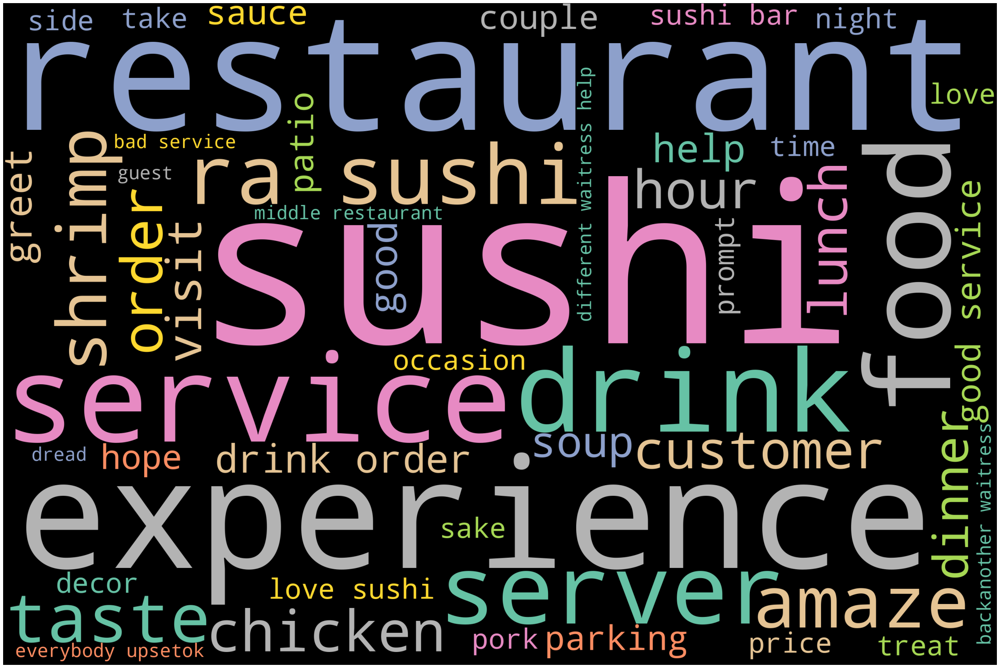

In [0]:
def plot_cloud(wordcloud):
    plt.figure(figsize=(40, 30))
    plt.imshow(wordcloud) 
    plt.axis("off")

wordcloud = WordCloud(width=3000, height=2000, colormap='Set2',
                      collocations=False, max_words=50)
wordcloud.generate_from_frequencies(frequencies=all_words_frequency)

plot_cloud(wordcloud)

In [0]:
rasushi_tips_keywords=[]
for i in tips_biz["keywords"]:
    i=ast.literal_eval(i)
    rasushi_tips_keywords.append(i)
    
rasushi_tips_keywords_pos = [item for sublist in rasushi_tips_keywords for item in sublist]
rasushi_tips_keywords_pos_frq = FreqDist(rasushi_tips_keywords_pos)

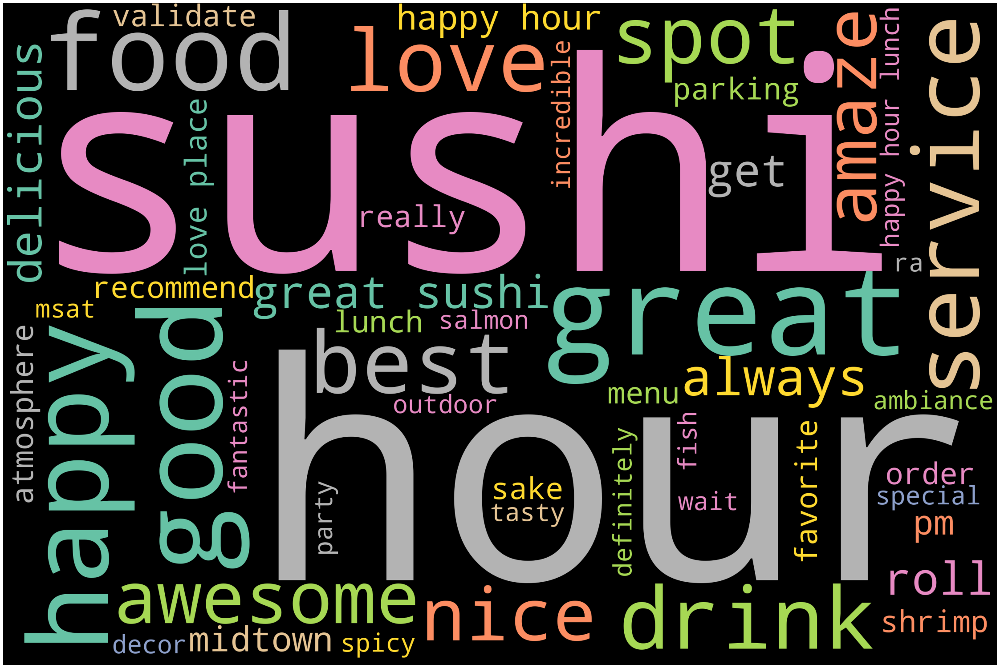

In [0]:
def plot_cloud(wordcloud):
    plt.figure(figsize=(40, 30))
    plt.imshow(wordcloud) 
    plt.axis("off")

wordcloud = WordCloud(width=3000, height=2000, colormap='Set2',
                      collocations=False, max_words=50)
wordcloud.generate_from_frequencies(frequencies=rasushi_tips_keywords_pos_frq)

plot_cloud(wordcloud)

In [0]:
comp_tips_keywords=[]
for i in comp_tips["keywords"]:
    i=ast.literal_eval(i)
    comp_tips_keywords.append(i)
    
comp_tips_keywords_pos = [item for sublist in comp_tips_keywords for item in sublist]
comp_tips_keywords_pos_frq = FreqDist(comp_tips_keywords_pos)

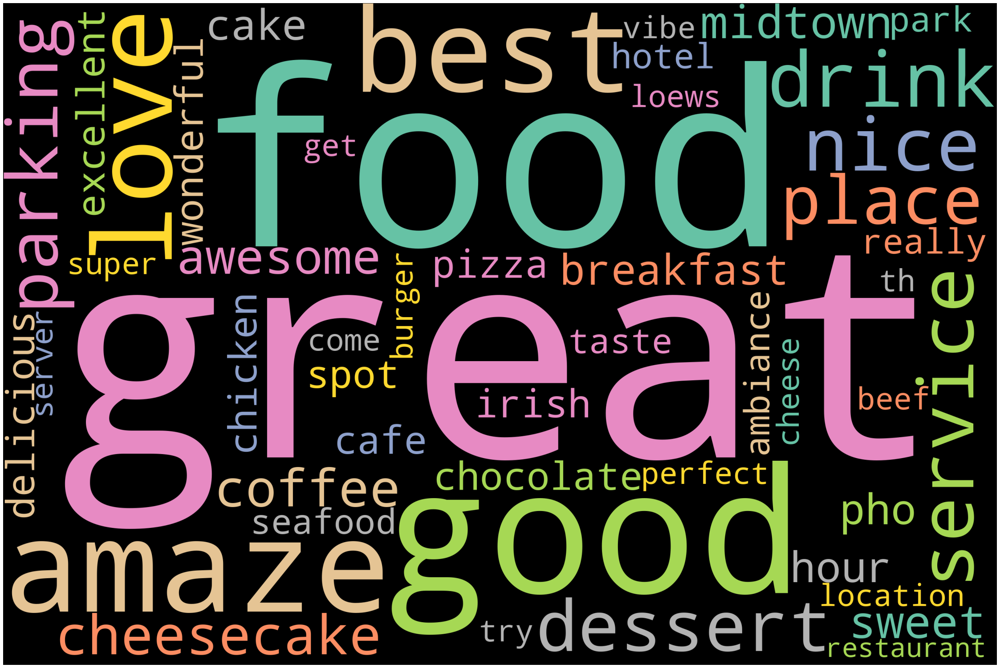

In [0]:
def plot_cloud(wordcloud):
    plt.figure(figsize=(40, 30))
    plt.imshow(wordcloud) 
    plt.axis("off")

wordcloud = WordCloud(width=3000, height=2000, colormap='Set2',
                      collocations=False, max_words=50)
wordcloud.generate_from_frequencies(frequencies=comp_tips_keywords_pos_frq)

plot_cloud(wordcloud)

In [0]:
reviews_comp_keywords=[]
for i in comp_reviews["keywords"]:
    i=ast.literal_eval(i)
    reviews_comp_keywords.append(i)
reviews_comp_keywords = [item for sublist in reviews_comp_keywords for item in sublist]
reviews_comp_keywords_frq = FreqDist(reviews_comp_keywords)

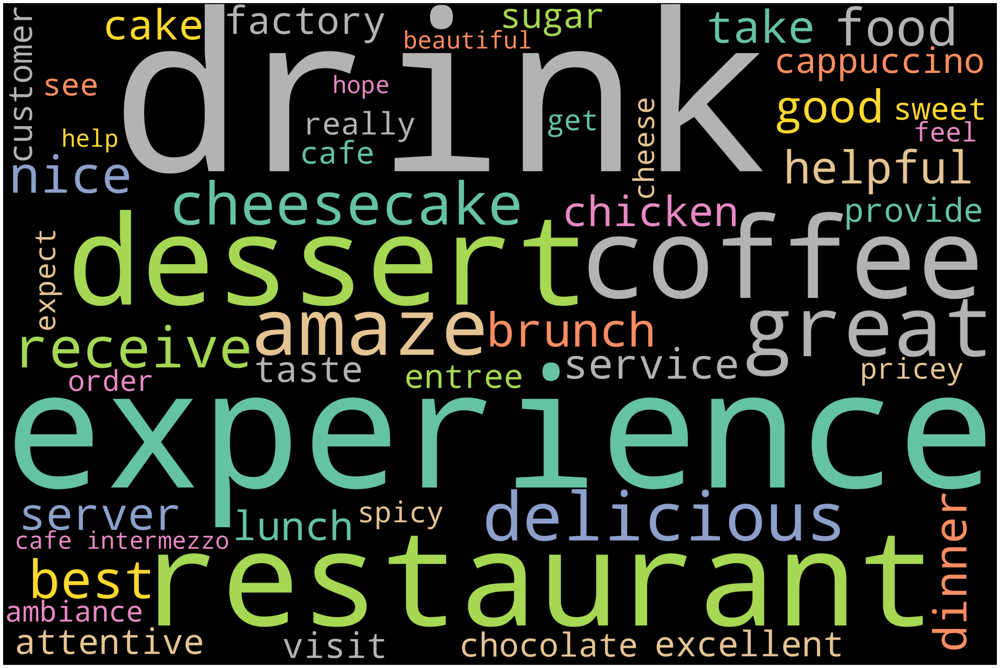

In [0]:
def plot_cloud(wordcloud):
    plt.figure(figsize=(40, 30))
    plt.imshow(wordcloud) 
    plt.axis("off")

wordcloud = WordCloud(width=3000, height=2000, colormap='Set2',
                      collocations=False, max_words=50)
wordcloud.generate_from_frequencies(frequencies=reviews_comp_keywords_frq)

plot_cloud(wordcloud)

## 5. Aspect Categorization of Negative Reviews

### 5.1 Clean Training Dataset

In [0]:
data = spark.read.format('csv').options(header='false', inferSchema='true').load("/FileStore/tables/aspect_cat_train.csv")
display(data)

_c0,_c1
Slow Service,slowest location planet earth never correct well never go
Slow Service,drive thru bad spend min wait food time home cold would definitely recommend go jack box street
Bad Food,drunk come order hot spicy sub mannaise ξwith mac sauce breakfast burrito tell get hot spicy fudge
Bad Food,crave fast food week decide try mcdonalds lunch break ξthe food suck ξthe nugget taste ξgrease drip fry ξthe ice machine ice ξa homeless man walk around store beg money ξi think go back nonmcdonaldsnonfast food way
Poor Service,cheap food hit miss service sketchy fuck especially men room basically typical mcmeal experience old restaurant update since oh fact seem like every time visit training somebody new odds right
Slow Service,always slow service none staff smile manager anthony go way show say may help thank transactionpretty much whole store refuse live mcdonalds service customer service standard
Order Problem,idiotic staff see yet simple order one double cheeseburger one fish sandwich one order medium fry one large coke manage screw four time last time manager swear guy must wake morning choose dumbest person work cash register
Bad Food,every time go mcdonalds swear line cook must smoker taste bud matter sandwich get way salt seriously ruin food every time visit daily work mall decent customer service polite knowledgeable however think others business hold customer service job
Order Problem,start oh yeah people watch place wonderful abundance tweekers crackheads amaze aside mcdonalds say food service good staff seem overwhelmed small lunch rush order miss hamburger main part one meal order apple juice part kid meal cup one drink fix quickly oh employee din area make floor super sticky think mop mop bucket clean spill soda guess nice would definitely would recommend try particular mcdonalds ξin across street
Poor Service,place unprofessional girl cashier even make eye contact customer fault employee unhappy visit location


In [0]:
data_pdf=data.toPandas()

In [0]:
data_pdf = pd.DataFrame(np.repeat(data_pdf.values, 10, axis=0))
data_pdf = data_pdf.sample(frac=1).reset_index(drop=True)


In [0]:
data_pdf.rename(columns={"_c0": "aspect category", "_c1":"review"},inplace=True)

In [0]:
data_pdf['review'] = data_pdf['review'].str.replace('http\S+|www.\S+|https\S+', '', case=False)
data_pdf['review'] = data_pdf['review'].apply(lambda x: re.split('https:\/\/.*', str(x))[0])

In [0]:
def text_cleaner(text):
    text = re.sub(r'@[A-Za-z0-9_]+','',text)
    text = re.sub("@[A-Za-z0-9_]+","", text)
    text = re.sub("#[A-Za-z0-9_]+","", text)
    text = re.sub(r"http\S+", "", text)
    text = re.sub(r"[0-9]*", "", text)
    text = re.sub(r"(”|“|-|\+|`|#|,|;|\|)*", "", text)
    text = re.sub(r"&amp", "", text)
    text = text.lower()

    return text
data_pdf['review']=data_pdf['review'].apply(text_cleaner)
data_pdf['review']=data_pdf['review'].str.replace('[{}]'.format(string.punctuation), '')

In [0]:
data_pdf=data_pdf.astype(str).apply(lambda x: x.str.encode('ascii', 'ignore').str.decode('ascii'))

In [0]:
def expand(text):
    # creating an empty list
    expanded_words = []    
    for word in text.split():
        # using contractions.fix to expand the shotened words
        expanded_words.append(contractions.fix(word))   
    expanded_text = ' '.join(expanded_words)
    return expanded_text

data_pdf['review']=data_pdf['review'].apply(expand)

In [0]:
stop_words = set(stopwords.words('english'))

def remove_Stopwords(text):
    word_tokens = word_tokenize(text)
    filtered_sentence = [w for w in word_tokens if not w.lower() in stop_words]
    filtered_sentence = []
    for w in word_tokens:
        if w not in stop_words:
            filtered_sentence.append(w)
    return filtered_sentence
 
data_pdf['review']=data_pdf['review'].apply(str).apply(remove_Stopwords)

In [0]:
def list_to_str(cell):
    cell = ' '.join(c for c in cell if c not in "'[]")
    return cell

data_pdf['review'] =data_pdf['review'].apply(list_to_str)

In [0]:
def get_wordnet_pos(word):
    tag = nltk.pos_tag([word])[0][1][0].upper()
    tag_dict = {"J": wordnet.ADJ,
                "N": wordnet.NOUN,
                "V": wordnet.VERB,
                "R": wordnet.ADV}
    return tag_dict.get(tag, wordnet.NOUN)



lemmatizer = WordNetLemmatizer()

def lemmatize(text):
    lem=[lemmatizer.lemmatize(w, get_wordnet_pos(w)) for w in nltk.word_tokenize(text)]
    return lem


data_pdf["review"]=data_pdf["review"].apply(lemmatize)

def list_to_str(cell):
    cell = ' '.join(c for c in cell if c not in "'[]")
    return cell

data_pdf["review"] =data_pdf["review"].apply(list_to_str)

### 5.2 Embed Training Dataset

In [0]:
y=data_pdf["aspect category"]
X=data_pdf["review"]

In [0]:
le = preprocessing.LabelEncoder()
y=le.fit_transform(y)

In [0]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [0]:
le = preprocessing.LabelEncoder()
y=le.fit_transform(y)

In [0]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [0]:
vectorizer = TextVectorization(max_tokens=20000, output_sequence_length=200)
text_ds = tf.data.Dataset.from_tensor_slices(X_train).batch(128)
vectorizer.adapt(text_ds)

In [0]:
voc = vectorizer.get_vocabulary()
word_index = dict(zip(voc, range(len(voc))))

In [0]:
embeddings_index = {}

dbutils.fs.cp("/FileStore/tables/glove_6B_100d.txt", 'file:/tmp/local-path')
f = open("/tmp/local-path", "r")

for line in f:
    word, coefs = line.split(maxsplit=1)
    coefs = np.fromstring(coefs, "f", sep=" ")
    embeddings_index[word] = coefs

print("Found %s word vectors." % len(embeddings_index))

Found 400000 word vectors.


In [0]:
num_tokens = len(voc) + 2
embedding_dim = 100
hits = 0
misses = 0

# Prepare embedding matrix
embedding_matrix = np.zeros((num_tokens, embedding_dim))
for word, i in word_index.items():
    embedding_vector = embeddings_index.get(word)
    if embedding_vector is not None:
        # Words not found in embedding index will be all-zeros.
        # This includes the representation for "padding" and "OOV"
        embedding_matrix[i] = embedding_vector
        hits += 1
    else:
        misses += 1
print("Converted %d words (%d misses)" % (hits, misses))

Converted 4109 words (1474 misses)


### 5.3 Build Model

In [0]:
embedding_layer = Embedding(
    num_tokens,
    embedding_dim,
    embeddings_initializer=keras.initializers.Constant(embedding_matrix),
    trainable=False,
)

In [0]:
int_sequences_input = keras.Input(shape=(None,), dtype="int64")
embedded_sequences = embedding_layer(int_sequences_input)
x = layers.Conv1D(64, 5, activation="relu")(embedded_sequences)
x = layers.MaxPooling1D(5)(x)
x = layers.Conv1D(64, 5, activation="relu")(x)
x = layers.MaxPooling1D(5)(x)
x = layers.Conv1D(64, 5, activation="relu")(x)
x = layers.GlobalMaxPooling1D()(x)
x = layers.Dense(64, activation="relu")(x)
x = layers.Dropout(0.5)(x)
preds = layers.Dense(4, activation="softmax")(x)
model = keras.Model(int_sequences_input, preds)
model.summary()

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, None)]            0         
                                                                 
 embedding_8 (Embedding)     (None, None, 100)         558500    
                                                                 
 conv1d_14 (Conv1D)          (None, None, 64)          32064     
                                                                 
 max_pooling1d_9 (MaxPooling  (None, None, 64)         0         
 1D)                                                             
                                                                 
 conv1d_15 (Conv1D)          (None, None, 64)          20544     
                                                                 
 max_pooling1d_10 (MaxPoolin  (None, None, 64)         0         
 g1D)                                                      

In [0]:
x_train = vectorizer(np.array([[s] for s in X_train])).numpy()
x_test = vectorizer(np.array([[s] for s in X_test])).numpy()
y_train = np.array(y_train)
y_test = np.array(y_test)

In [0]:
earlystopping=keras.callbacks.EarlyStopping(monitor='val_loss',
                              min_delta=0,
                              patience=1,
                              verbose=0, mode='auto')
model.compile(
    loss="sparse_categorical_crossentropy", optimizer="rmsprop", metrics=["acc"]
)
history=model.fit(x_train, y_train, batch_size=128, epochs=20, validation_data=(x_test, y_test),callbacks =[earlystopping])

Epoch 1/20
64/64 [==============================] - 10s 146ms/step - loss: 1.2667 - acc: 0.4078 - val_loss: 1.1690 - val_acc: 0.4671
Epoch 2/20
64/64 [==============================] - 9s 147ms/step - loss: 0.9461 - acc: 0.6206 - val_loss: 0.6787 - val_acc: 0.8184
Epoch 3/20
64/64 [==============================] - 9s 144ms/step - loss: 0.6100 - acc: 0.7905 - val_loss: 0.3162 - val_acc: 0.9362
Epoch 4/20
64/64 [==============================] - 10s 148ms/step - loss: 0.3680 - acc: 0.8933 - val_loss: 0.1069 - val_acc: 0.9892
Epoch 5/20
64/64 [==============================] - 9s 144ms/step - loss: 0.2626 - acc: 0.9322 - val_loss: 0.0573 - val_acc: 0.9971
Epoch 6/20
64/64 [==============================] - 9s 141ms/step - loss: 0.1477 - acc: 0.9669 - val_loss: 0.0177 - val_acc: 0.9995
Epoch 7/20
64/64 [==============================] - 9s 143ms/step - loss: 0.1396 - acc: 0.9725 - val_loss: 0.0070 - val_acc: 0.9995
Epoch 8/20
64/64 [==============================] - 9s 146ms/step - loss: 

In [0]:
_, train_acc = model.evaluate(x_train, y_train, verbose=0)
_, test_acc = model.evaluate(x_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))

Train: 0.817, Test: 0.809


### 5.4 Apply on Yelp Dataset

In [0]:
reviews_neg = review_pdf[review_pdf.sentiment=="negative"]

In [0]:
X_pred = reviews_neg["text"]

In [0]:
x_pred = np.array_split(X_pred, 10)

In [0]:
classes_list=[]
for i in range(len(x_pred)):
    x_pred_vec=vectorizer(np.array([[s] for s in x_pred[i]])).numpy()
    y_pred = model.predict(x_pred_vec)
    y_classes = y_pred.argmax(axis=-1)
    classes_list.append(y_classes)

In [0]:
flat_list = []
for sublist in classes_list:
    for item in sublist:
        flat_list.append(item)

In [0]:
flat_list=list(le.inverse_transform(flat_list))

In [0]:
reviews_neg["aspect_category"]=flat_list

<command-3954743671503303>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  reviews_neg["aspect_category"]=flat_list


### 6. Visualize Results

In [0]:
business_neg = reviews_neg[reviews_neg.business_id=="s7baMoiG1821_3NblCfK6w"]

In [0]:
business_neg

,aspect_category,business_id,comp_score,sentiment,stars,text
22982,Order Problem,s7baMoiG1821_3NblCfK6w,-0.3818,negative,1.0,terrible togo service order food go total orde...
23958,Slow Service,s7baMoiG1821_3NblCfK6w,-0.9535,negative,1.0,beware bad sushi place ever food really unorga...
29664,Slow Service,s7baMoiG1821_3NblCfK6w,-0.0516,negative,1.0,order food grubhub card charge never receive o...
29705,Bad Food,s7baMoiG1821_3NblCfK6w,-0.3830,negative,1.0,get teriyaki salmon bowl lunch portion extreme...
30012,Bad Food,s7baMoiG1821_3NblCfK6w,-0.9477,negative,1.0,rd bad sushi ever eat make point eat japanese ...
...,...,...,...,...,...,...
199005,Order Problem,s7baMoiG1821_3NblCfK6w,-0.4767,negative,1.0,brought family birthday dinner several order w...
199108,Slow Service,s7baMoiG1821_3NblCfK6w,-0.1280,negative,1.0,sushi price staff rude accommodate charge sing...
199355,Bad Food,s7baMoiG1821_3NblCfK6w,-0.7514,negative,1.0,terrible order roll goyoza oz rice get tiny ro...
199527,Slow Service,s7baMoiG1821_3NblCfK6w,-0.8107,negative,2.0,sat table reservation wait minute service serv...


In [0]:
business_2_neg = reviews_neg[reviews_neg.business_id=='hmrRb7qX3K705MuxHHfgNA']
business_3_neg = reviews_neg[reviews_neg.business_id=='B_6V-u97NU8aai4mrKqwNw']
business_4_neg = reviews_neg[reviews_neg.business_id=='kD1mjIbvczeXBxDSluJaOw']
business_5_neg = reviews_neg[reviews_neg.business_id== '6Rq3Bcs969L60aoMGIs5FQ']
business_6_neg = reviews_neg[reviews_neg.business_id=='7Gub6fxNR1kkPp2MKm2ikw']
business_7_neg = reviews_neg[reviews_neg.business_id=='MeQegzmVVKNuu-ojlszjRQ']
business_8_neg = reviews_neg[reviews_neg.business_id=='_vocxUlPxxOafG18HE_B-A']
business_9_neg = reviews_neg[reviews_neg.business_id=='CcIS8RDNCtJUbxCduIEyAg']

In [0]:
all_business = pd.concat([business_neg, business_2_neg,business_3_neg,business_4_neg,business_5_neg,business_6_neg,business_7_neg,business_8_neg,business_9_neg])

In [0]:
all_business = all_business.merge(biz_pdf[["business_id","name"]])

In [0]:
all_business

,aspect_category,business_id,comp_score,sentiment,stars,text,name
0,Order Problem,s7baMoiG1821_3NblCfK6w,-0.3818,negative,1.0,terrible togo service order food go total orde...,RA Sushi Bar Restaurant
1,Slow Service,s7baMoiG1821_3NblCfK6w,-0.9535,negative,1.0,beware bad sushi place ever food really unorga...,RA Sushi Bar Restaurant
2,Slow Service,s7baMoiG1821_3NblCfK6w,-0.0516,negative,1.0,order food grubhub card charge never receive o...,RA Sushi Bar Restaurant
3,Bad Food,s7baMoiG1821_3NblCfK6w,-0.3830,negative,1.0,get teriyaki salmon bowl lunch portion extreme...,RA Sushi Bar Restaurant
4,Bad Food,s7baMoiG1821_3NblCfK6w,-0.9477,negative,1.0,rd bad sushi ever eat make point eat japanese ...,RA Sushi Bar Restaurant
...,...,...,...,...,...,...,...
175,Slow Service,CcIS8RDNCtJUbxCduIEyAg,-0.5859,negative,1.0,first could give zero definitely would moment ...,Sugar Factory
176,Slow Service,CcIS8RDNCtJUbxCduIEyAg,-0.5267,negative,1.0,say bad experience I establishment mean wholeh...,Sugar Factory
177,Slow Service,CcIS8RDNCtJUbxCduIEyAg,-0.9259,negative,1.0,terrible service constantly get order wrong en...,Sugar Factory
178,Slow Service,CcIS8RDNCtJUbxCduIEyAg,-0.7783,negative,1.0,food terrible service somehow bad food never g...,Sugar Factory


Out[290]: <AxesSubplot:xlabel='aspect_category', ylabel='count'>

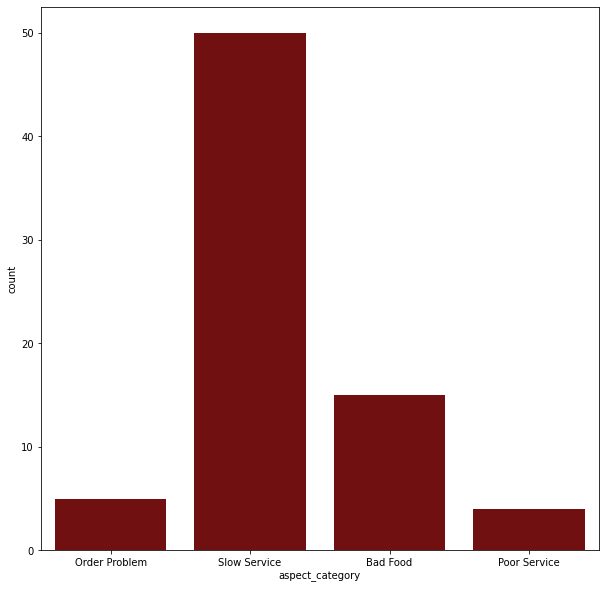

In [0]:
import seaborn as sns
fig, axes = plt.subplots(1, figsize=(10,10), sharey=True)
sns.countplot(x="aspect_category", data=business_neg,color="maroon")

Out[286]: <AxesSubplot:xlabel='name', ylabel='count'>

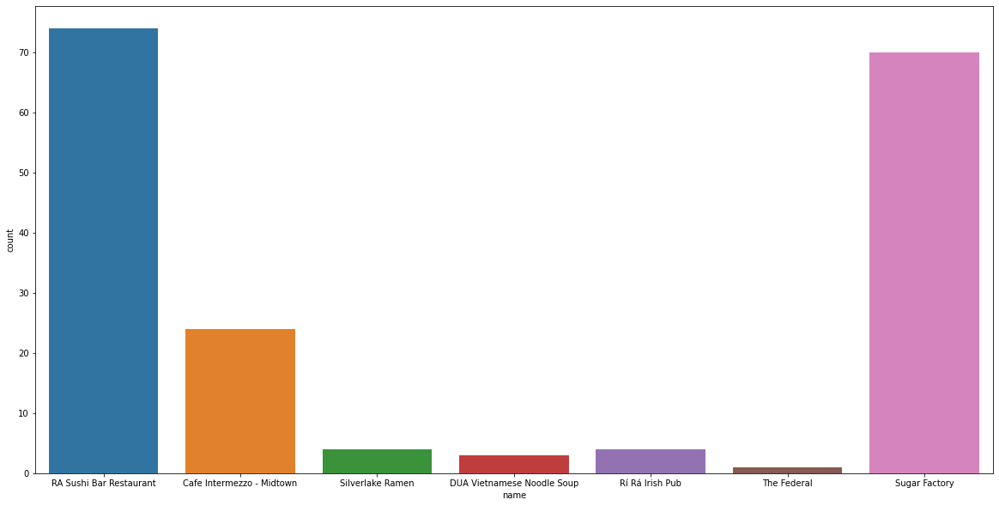

In [0]:
fig, axes = plt.subplots(1, figsize=(20, 10), sharey=True)
sns.countplot(x="name",  data=all_business)

Out[266]: <AxesSubplot:xlabel='count', ylabel='name'>

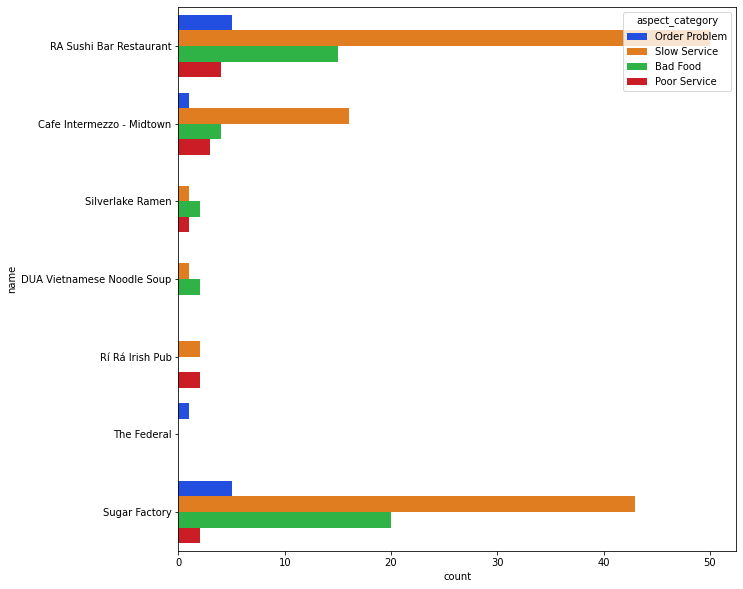

In [0]:
import seaborn as sns
fig, axes = plt.subplots(1, figsize=(10,10), sharey=True)
sns.countplot(y="name", hue="aspect_category", data=all_business,palette="bright")

In [0]:
ra_sushi_neg["aspect_category"].value_counts()

Out[195]: Slow Service     50
Bad Food         15
Order Problem     5
Poor Service      4
Name: aspect_category, dtype: int64

### 7. Apply keyword extraction

In [0]:
business_neg_ss = business_neg[business_neg.aspect_category=="Slow Service"]
business_neg_bf = business_neg[business_neg.aspect_category=="Bad Food"]
business_neg_op = business_neg[business_neg.aspect_category=="Order Problem"]
business_neg_ps = business_neg[business_neg.aspect_category=="Poor Service"]

In [0]:
business_neg_ss["keywords"]=business_neg_ss["text"].apply(keywords)
business_neg_bf["keywords"]=business_neg_bf["text"].apply(keywords)
business_neg_op["keywords"]=business_neg_op["text"].apply(keywords)
business_neg_ps["keywords"]=business_neg_ps["text"].apply(keywords)

<command-3954743671503312>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  business_neg_ss["keywords"]=business_neg_ss["text"].apply(keywords)
<command-3954743671503312>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  business_neg_bf["keywords"]=business_neg_bf["text"].apply(keywords)
<command-3954743671503312>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:/

In [0]:
ra_sushi_all_keywords = pd.concat([business_neg_ss, business_neg_bf,business_neg_op,business_neg_ps])

In [0]:
biz_neg_ss_keywords=[]
for i in business_neg_ss["keywords"]:
    biz_neg_ss_keywords.append(i)

biz_neg_bf_keywords=[]
for i in business_neg_bf["keywords"]:
    biz_neg_bf_keywords.append(i)

biz_neg_op_keywords=[]
for i in business_neg_op["keywords"]:
    biz_neg_op_keywords.append(i)
    
biz_neg_ps_keywords=[]
for i in business_neg_ps["keywords"]:
    biz_neg_ps_keywords.append(i)

In [0]:
biz_neg_ss_keywords = [item for sublist in biz_neg_ss_keywords for item in sublist]
biz_neg_bf_keywords = [item for sublist in biz_neg_bf_keywords for item in sublist]
biz_neg_op_keywords = [item for sublist in biz_neg_op_keywords for item in sublist]
biz_neg_ps_keywords = [item for sublist in biz_neg_ps_keywords for item in sublist]

In [0]:
biz_neg_ss_keywords_freq = FreqDist(biz_neg_ss_keywords)
biz_neg_bf_keywords_freq = FreqDist(biz_neg_bf_keywords)
biz_neg_ps_keywords_freq = FreqDist(biz_neg_ps_keywords)
biz_neg_op_keywords_freq = FreqDist(biz_neg_op_keywords)

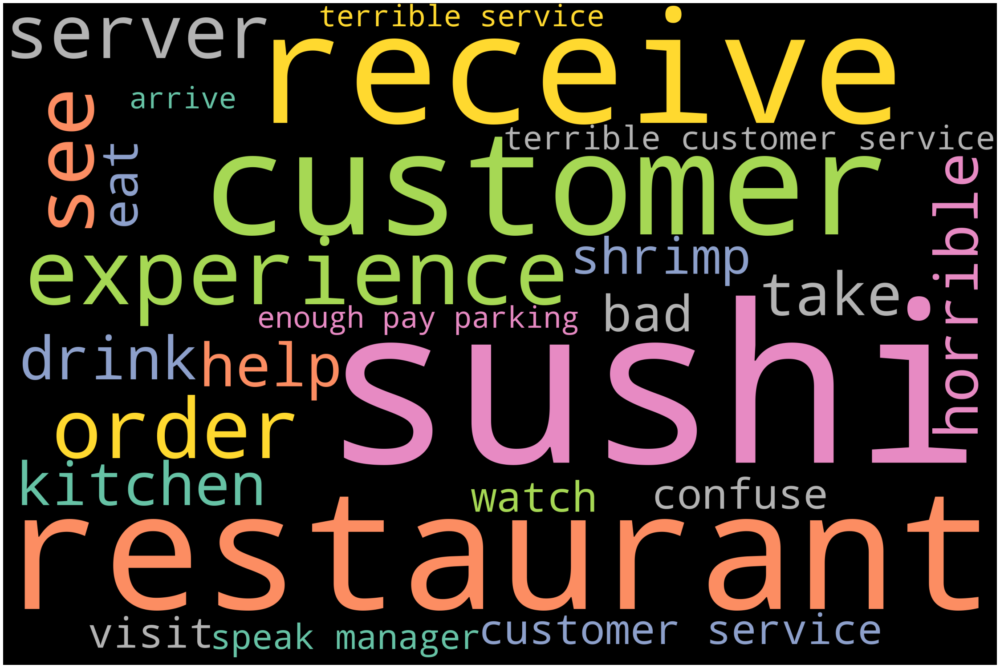

In [0]:
def plot_cloud(wordcloud):
    plt.figure(figsize=(40, 30))
    plt.imshow(wordcloud) 
    plt.axis("off")

wordcloud = WordCloud(width=3000, height=2000, colormap='Set2',
                      collocations=False, max_words=25)
wordcloud.generate_from_frequencies(frequencies=biz_neg_ss_keywords_freq)

plot_cloud(wordcloud)

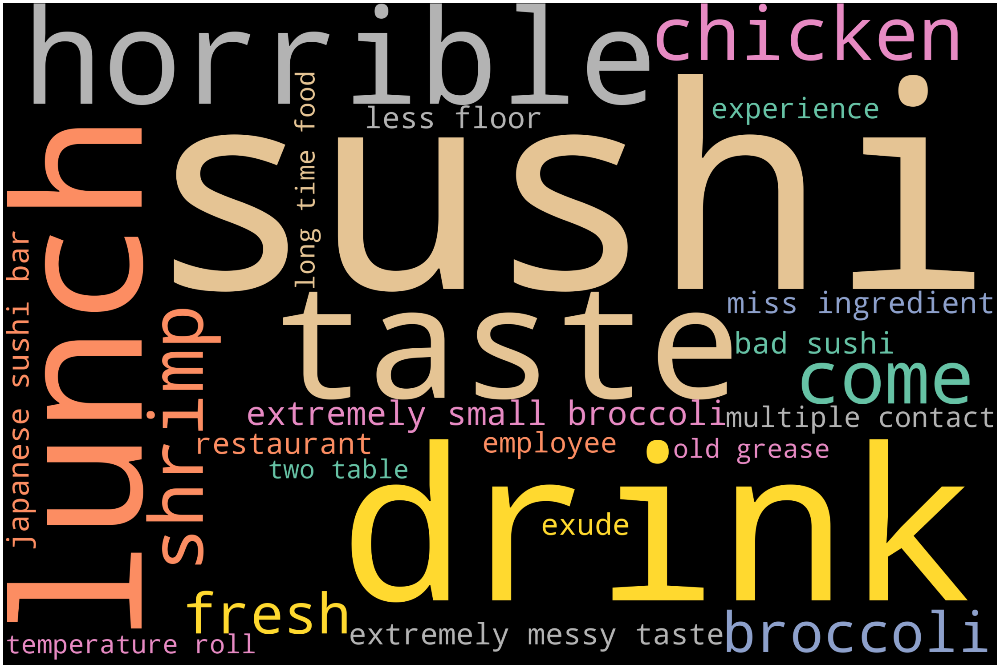

In [0]:
def plot_cloud(wordcloud):
    plt.figure(figsize=(40, 30))
    plt.imshow(wordcloud) 
    plt.axis("off")

wordcloud = WordCloud(width=3000, height=2000, colormap='Set2',
                      collocations=False, max_words=25)
wordcloud.generate_from_frequencies(frequencies=biz_neg_bf_keywords_freq)

plot_cloud(wordcloud)

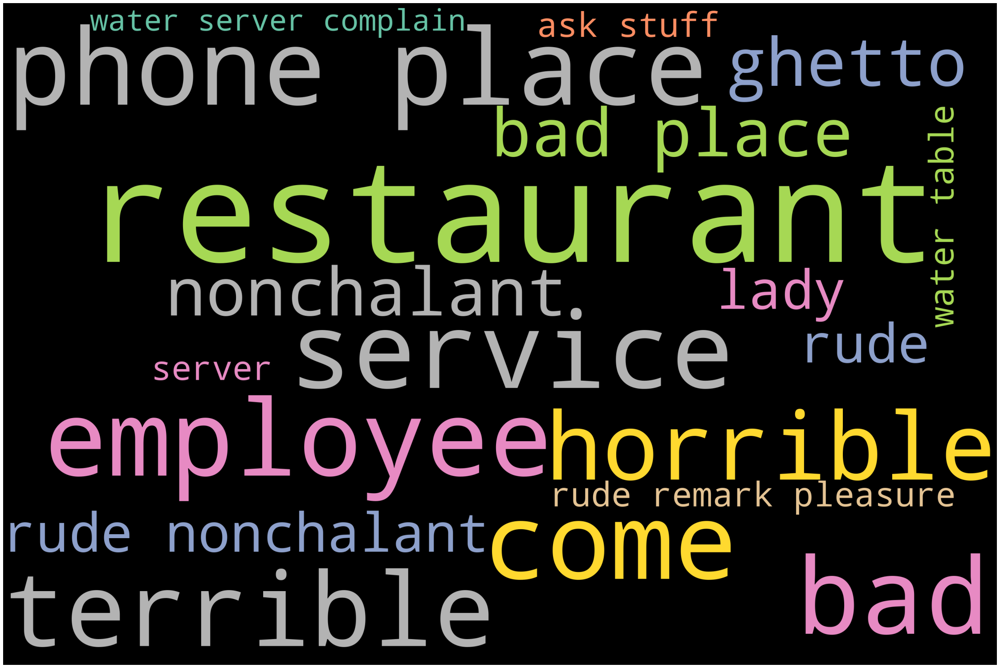

In [0]:
def plot_cloud(wordcloud):
    plt.figure(figsize=(40, 30))
    plt.imshow(wordcloud) 
    plt.axis("off")

wordcloud = WordCloud(width=3000, height=2000, colormap='Set2',
                      collocations=False, max_words=25)
wordcloud.generate_from_frequencies(frequencies=biz_neg_ps_keywords_freq)

plot_cloud(wordcloud)

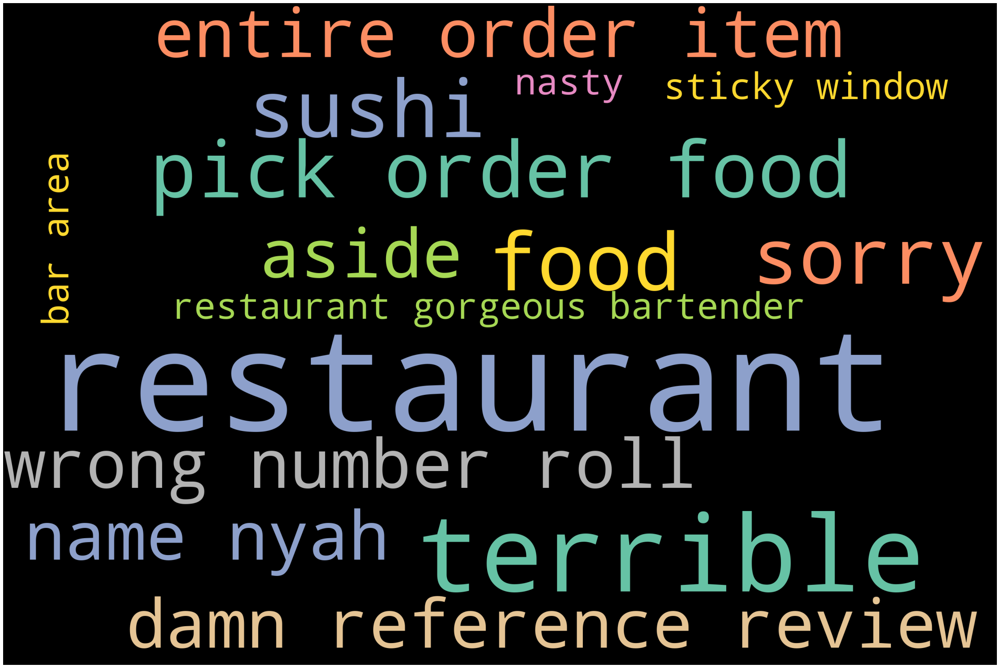

In [0]:
def plot_cloud(wordcloud):
    plt.figure(figsize=(40, 30))
    plt.imshow(wordcloud) 
    plt.axis("off")

wordcloud = WordCloud(width=3000, height=2000, colormap='Set2',
                      collocations=False, max_words=15)
wordcloud.generate_from_frequencies(frequencies=biz_neg_op_keywords_freq)

plot_cloud(wordcloud)